In [1]:
using ModelingToolkit
using Plots
using DifferentialEquations

In [2]:
@variables t
D = Differential(t)
include("healthy_human_parameters.jl")
include("circulatory_system_components.jl")

CR

# Elastance function

In [3]:
function Elastance(t, E_min, E_max, T, T_es, T_ep, Eshift)
    # Get time relative to start of cycle
    t_i = rem(t + (1 - Eshift) * T, T)

    E_p = (t_i <= T_es) * (1 - cos(t_i / T_es * pi)) / 2 +
         (t_i > T_es) * (t_i <= T_ep) * (1 + cos((t_i - T_es) / (T_ep - T_es) * pi)) / 2 +
         (t_i > T_ep) * 0

    E = E_min + (E_max - E_min) * E_p

    return E
end


Elastance (generic function with 1 method)

# Solving Scenarios

In [4]:
function plot_setup(plot_title, x_label, y_label)
    return plot(xlabel=x_label, ylabel=y_label, legend=false, title=plot_title, yguidefontsize=12, ytickfontsize=12, xguidefontsize=12, xtickfontsize=12)
end

plot_setup (generic function with 1 method)

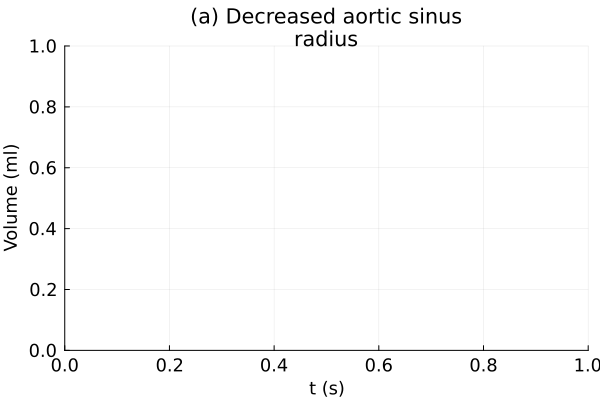

In [5]:
plot_title = "(a) Decreased aortic sinus\nradius"

p_rv_pt_ao_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_ao_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_ao_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_ao_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_ao_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_ao_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_ao_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_ao_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_ao_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_ao_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_ao_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_ao_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_ao_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_ao_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_ao_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_ao_r = plot_setup(plot_title, "t (s)", "Volume (ml)");

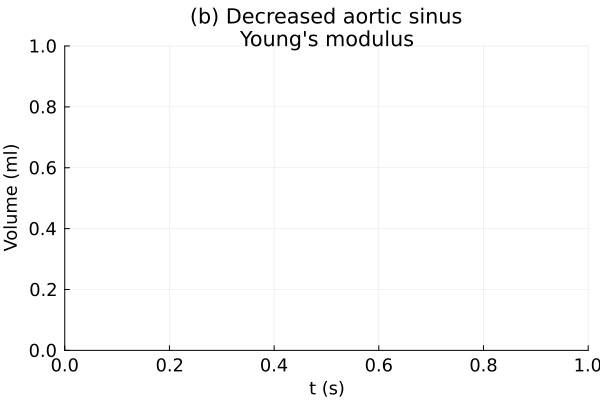

In [6]:
plot_title = "(b) Decreased aortic sinus\nYoung's modulus"

p_rv_pt_ao_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_ao_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_ao_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_ao_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_ao_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_ao_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_ao_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_ao_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_ao_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_ao_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_ao_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_ao_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_ao_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_ao_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_ao_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_ao_ym = plot_setup(plot_title, "t (s)", "Volume (ml)");

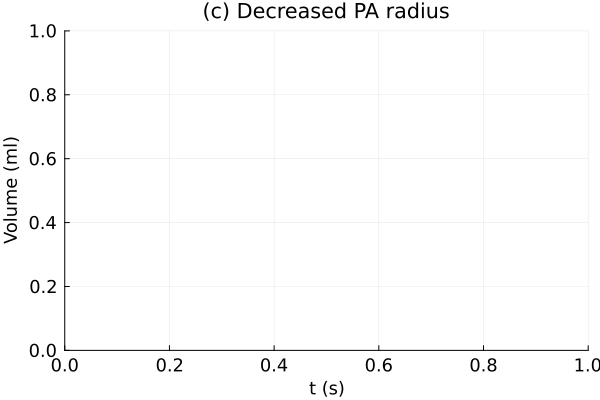

In [7]:
plot_title = "(c) Decreased PA radius"

p_rv_pt_pa_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_pa_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_pa_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_pa_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_pa_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_pa_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_pa_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_pa_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_pa_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_pa_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_pa_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_pa_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_pa_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_pa_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_pa_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_pa_r = plot_setup(plot_title, "t (s)", "Volume (ml)");

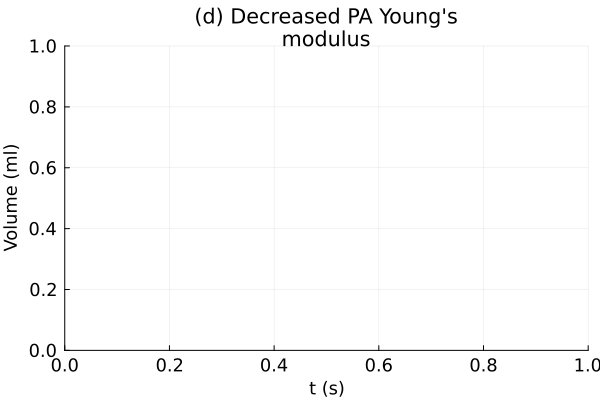

In [8]:
plot_title = "(d) Decreased PA Young's\nmodulus"

p_rv_pt_pa_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_pa_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_pa_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_pa_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_pa_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_pa_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_pa_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_pa_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_pa_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_pa_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_pa_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_pa_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_pa_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_pa_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_pa_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_pa_ym = plot_setup(plot_title, "t (s)", "Volume (ml)");

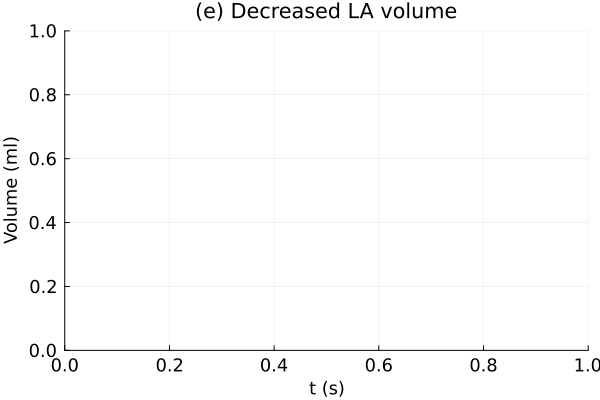

In [9]:
plot_title = "(e) Decreased LA volume"

p_rv_pt_la_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_la_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_la_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_la_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_la_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_la_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_la_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_la_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_la_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_la_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_la_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_la_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_la_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_la_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_la_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_la_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)");

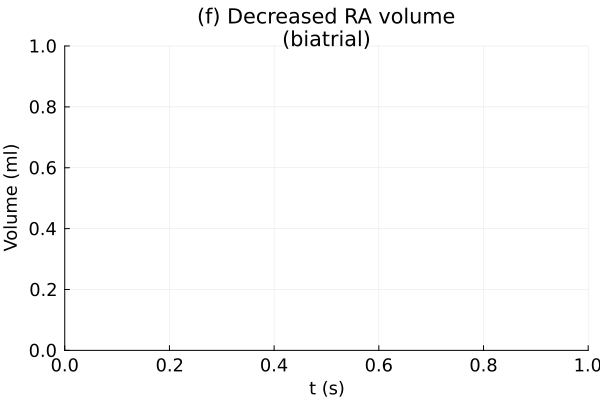

In [10]:
plot_title = "(f) Decreased RA volume\n(biatrial)"

p_rv_pt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_ra_v0_ba = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_ra_v0_ba = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_ra_v0_ba = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_ra_v0_ba = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_ra_v0_ba = plot_setup(plot_title, "t (s)", "Volume (ml)");

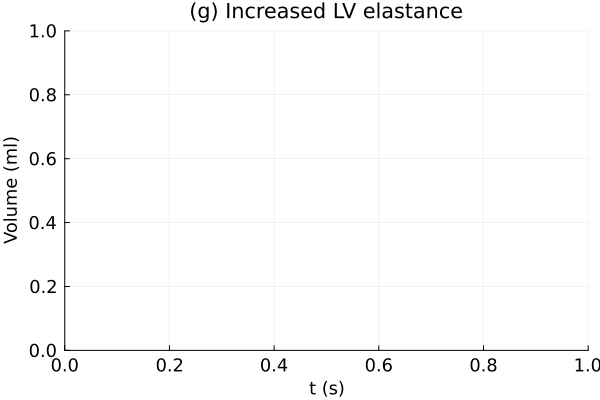

In [11]:
plot_title = "(g) Increased LV elastance"

p_rv_pt_lv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_lv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_lv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_lv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_lv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_lv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_lv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_lv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_lv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_lv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_lv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_lv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_lv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_lv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_lv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_lv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)");

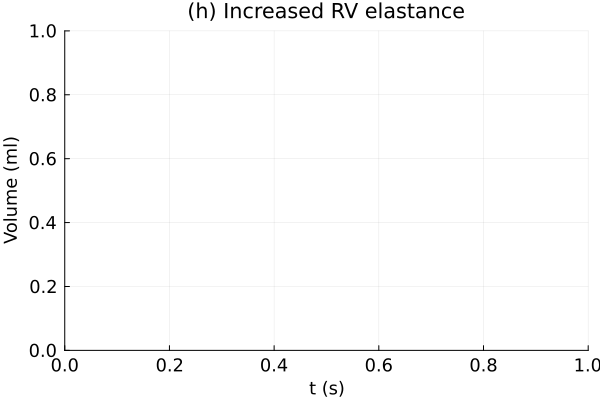

In [12]:
plot_title = "(h) Increased RV elastance"

p_rv_pt_rv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_rv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_rv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_rv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_rv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_rv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_rv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_rv_emax = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_rv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_rv_emax = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_rv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_rv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_rv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_rv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_rv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_rv_emax = plot_setup(plot_title, "t (s)", "Volume (ml)");

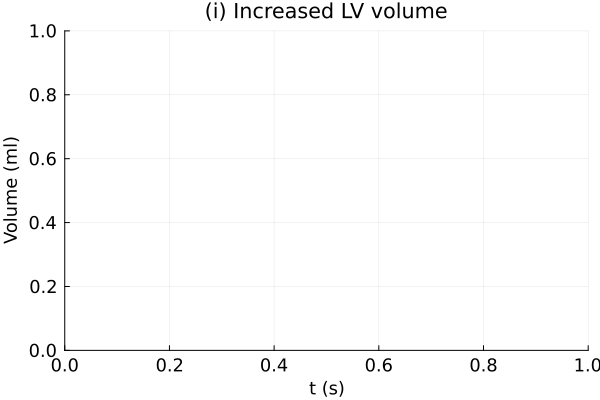

In [13]:
plot_title = "(i) Increased LV volume"

p_rv_pt_lv_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_lv_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_lv_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_lv_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_lv_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_lv_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_lv_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_lv_v0 = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_lv_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_lv_v0 = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_lv_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_lv_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_lv_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_lv_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_lv_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_lv_v0 = plot_setup(plot_title, "t (s)", "Volume (ml)");

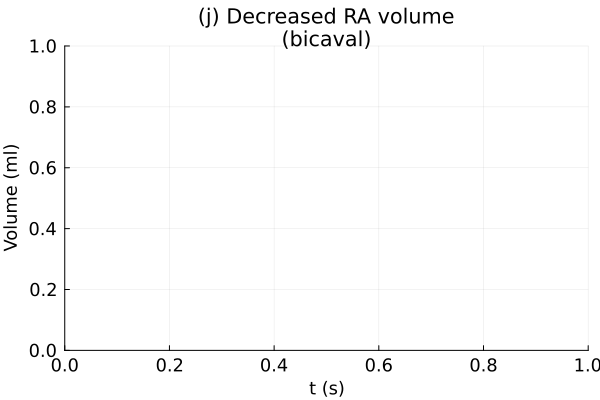

In [14]:
plot_title = "(j) Decreased RA volume\n(bicaval)"

p_rv_pt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_ra_v0_bc = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_ra_v0_bc = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_ra_v0_bc = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_ra_v0_bc = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_ra_v0_bc = plot_setup(plot_title, "t (s)", "Volume (ml)");

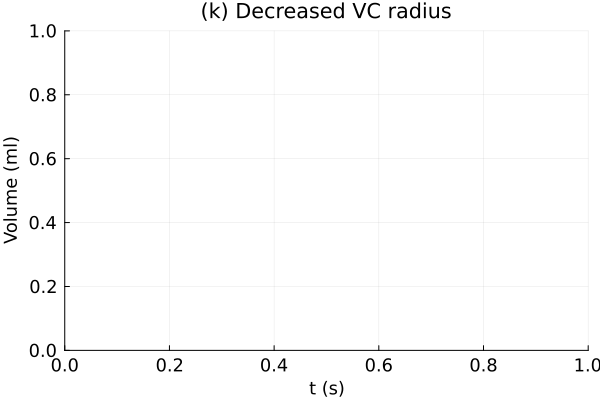

In [15]:
plot_title = "(k) Decreased VC radius"

p_rv_pt_vc_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_vc_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_vc_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_vc_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_vc_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_vc_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_vc_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_vc_r = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_vc_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_vc_r = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_vc_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_vc_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_vc_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_vc_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_vc_r = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_vc_r = plot_setup(plot_title, "t (s)", "Volume (ml)");

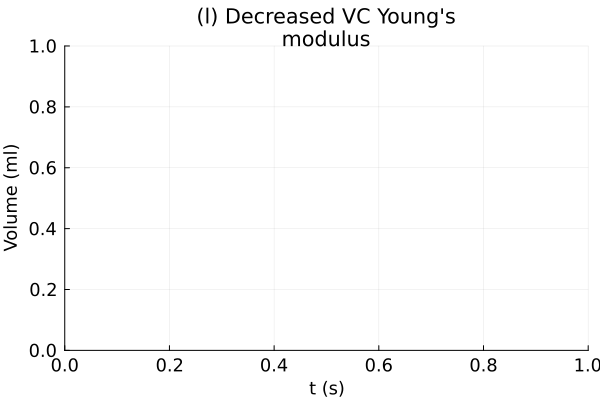

In [16]:
plot_title = "(l) Decreased VC Young's\nmodulus"

p_rv_pt_vc_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_ra_pt_vc_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_pt_vc_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_la_pt_vc_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_rv_pv_vc_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ra_pv_vc_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_lv_pv_vc_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_la_pv_vc_ym = plot_setup(plot_title, "Volume (ml)", "Pressure (mmHg)")
p_ao_pt_vc_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_pa_pt_vc_ym = plot_setup(plot_title, "t (s)", "Pressure (mmHg)")
p_lv_vt_vc_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_rv_vt_vc_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_la_vt_vc_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ra_vt_vc_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_ao_vt_vc_ym = plot_setup(plot_title, "t (s)", "Volume (ml)")
p_pa_vt_vc_ym = plot_setup(plot_title, "t (s)", "Volume (ml)");

## Reference healthy human (default)

In [17]:
# Heart chambers
@named LV = HeartChamber(V_0=v0_lv, p_0=p0_lv, E_min=Emin_lv, E_max=Emax_lv, T=T, T_es=Tes_lv, T_ep=Ted_lv, Eshift=0.0)
@named LA = HeartChamber(V_0=v0_la, p_0=p0_la, E_min=Emin_la, E_max=Emax_la, T=T, T_es=Tpww_la / 2, T_ep=Tpww_la, Eshift=Tpwb_la)
@named RV = HeartChamber(V_0=v0_rv, p_0=p0_rv, E_min=Emin_rv, E_max=Emax_rv, T=T, T_es=Tes_rv, T_ep=Ted_rv, Eshift=0.0)
@named RA = HeartChamber(V_0=v0_ra, p_0=p0_ra, E_min=Emin_ra, E_max=Emax_ra, T=T, T_es=Tpww_ra / 2, T_ep=Tpww_ra, Eshift=Tpwb_ra)

# Valves
@named AV = HeartValve(CQ=CQ_AV)
@named MV = HeartValve(CQ=CQ_MV)
@named TV = HeartValve(CQ=CQ_TV)
@named PV = HeartValve(CQ=CQ_PV)

# Systemic circulation
@named SAS = CRL(C=Csas, R=Rsas, L=Lsas)
@named SAT = CRL(C=Csat, R=Rsat, L=Lsat)
@named SAR = Resistor(R=Rsar)
@named SCP = Resistor(R=Rscp)
@named SVN = CR(R=Rsvn, C=Csvn)

# Pulmonary circulatioin
@named PAS = CRL(C=Cpas, R=Rpas, L=Lpas)
@named PAT = CRL(C=Cpat, R=Rpat, L=Lpat)
@named PAR = Resistor(R=Rpar)
@named PCP = Resistor(R=Rpcp)
@named PVN = CR(R=Rpvn, C=Cpvn);

In [18]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20);


retcode: Success
Interpolation: 1st order linear
t: 101-element Vector{Float64}:
 19.0
 19.01
 19.02
 19.03
 19.04
 19.05
 19.06
 19.07
 19.08
 19.09
  ⋮
 19.92
 19.93
 19.94
 19.95
 19.96
 19.97
 19.98
 19.99
 20.0
u: 101-element Vector{Vector{Float64}}:
 [141.70690421608103, 136.34130010881935, 64.77526914035182, 58.17893479511977, 7.410395166684641, 3.3424445544380093, 148.19203734757775, 70.18322542333979, 360.55295467014747, 5.8968649038456205, 2.78520028946567, 124.46818296217683, 61.605559765208746, 279.87715668919594]
 [141.70690421608103, 136.34130010881935, 69.4940907364068, 59.266310332116014, 7.3770596504196835, 3.324707836797832, 147.52540920035545, 69.81053187524009, 360.16554279663853, 5.868992548788786, 2.7903822900715856, 123.87960311534647, 61.70064541297051, 275.77478729502815]
 [141.70690421608103, 136.34130010881935, 73.24543269169058, 60.35793698829577, 7.3439005653693314, 3.3071139740541433, 146.86231153642373, 69.44102474917294, 359.7701728894408, 5.841062340208

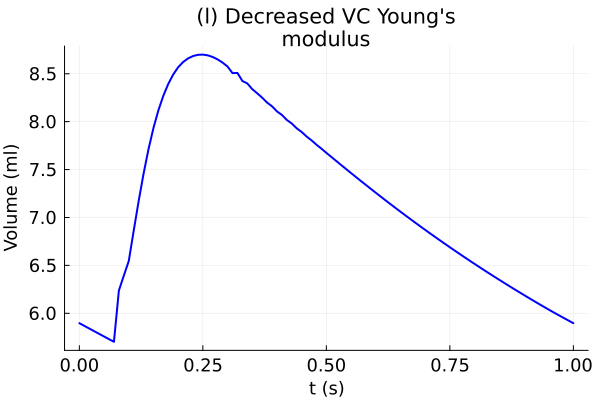

In [19]:
plot!(p_rv_pt_ao_r, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_ao_r, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_ao_r, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_ao_r, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_ao_r, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_ao_r, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_ao_r, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_ao_r, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_ao_r, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_ao_r, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_ao_r, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_ao_r, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_ao_r, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_ao_r, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_ao_r, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_ao_r, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_ao_ym, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_ao_ym, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_ao_ym, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_ao_ym, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_pa_r, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_pa_r, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_pa_r, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_pa_r, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_pa_r, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_pa_r, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_pa_r, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_pa_r, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_pa_r, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_pa_r, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_pa_r, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_pa_r, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_pa_r, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_pa_r, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_pa_r, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_pa_r, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_pa_ym, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_pa_ym, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_pa_ym, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_pa_ym, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_la_v0, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_la_v0, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_la_v0, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_la_v0, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_la_v0, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_la_v0, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_la_v0, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_la_v0, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_la_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_la_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_la_v0, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_la_v0, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_la_v0, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_la_v0, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_la_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_la_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_ra_v0_ba, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_ra_v0_ba, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_ra_v0_ba, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_ra_v0_ba, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_lv_emax, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_lv_emax, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_lv_emax, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_lv_emax, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_rv_emax, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_rv_emax, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_rv_emax, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_rv_emax, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_lv_v0, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_lv_v0, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_lv_v0, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_lv_v0, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_ra_v0_bc, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_ra_v0_bc, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_ra_v0_bc, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_ra_v0_bc, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_vc_r, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_vc_r, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_vc_r, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_vc_r, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_vc_r, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_vc_r, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_vc_r, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_vc_r, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_vc_r, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_vc_r, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_vc_r, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_vc_r, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_vc_r, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_vc_r, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_vc_r, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_vc_r, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue)

plot!(p_rv_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_rv_pv_vc_ym, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linecolor=:blue)
plot!(p_ra_pv_vc_ym, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linecolor=:blue)
plot!(p_lv_pv_vc_ym, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linecolor=:blue)
plot!(p_la_pv_vc_ym, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linecolor=:blue)
plot!(p_ao_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_pa_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linecolor=:blue)
plot!(p_rv_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linecolor=:blue)
plot!(p_ra_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linecolor=:blue)
plot!(p_lv_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linecolor=:blue)
plot!(p_la_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linecolor=:blue)
plot!(p_ao_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linecolor=:blue)
plot!(p_pa_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linecolor=:blue);

## Aorta radius

In [20]:
@named SAS = CRL(C=Csas*0.125, R=Rsas*16, L=Lsas*4);

In [21]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)

plot!(p_rv_pt_ao_r, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_ao_r, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_ao_r, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_ao_r, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_ao_r, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_ao_r, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_ao_r, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_ao_r, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_ao_r, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_ao_r, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_ao_r, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_ao_r, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_ao_r, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_ao_r, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_ao_r, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_ao_r, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [22]:
@named SAS = CRL(C=Csas, R=Rsas, L=Lsas);

Model SAS with 14 (24) equations
States (24):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (5):
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 0.08]
  C₊p_rel [defaults to 0.0]
  R₊R [defaults to 0.003]
⋮

## Aorta YM

In [23]:
@named SAS = CRL(C=Csas*3, R=Rsas, L=Lsas);

In [24]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)

plot!(p_rv_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_ao_ym, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_ao_ym, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_ao_ym, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_ao_ym, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_ao_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_ao_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [25]:
@named SAS = CRL(C=Csas, R=Rsas, L=Lsas);

Model SAS with 14 (24) equations
States (24):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (5):
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 0.08]
  C₊p_rel [defaults to 0.0]
  R₊R [defaults to 0.003]
⋮

## PA radius

In [27]:
@named PAS = CRL(C=Cpas*0.204, R=Rpas*8.352, L=Lpas*2.89);

In [28]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_pa_r, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_pa_r, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_pa_r, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_pa_r, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_pa_r, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_pa_r, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_pa_r, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_pa_r, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_pa_r, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_pa_r, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_pa_r, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_pa_r, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_pa_r, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_pa_r, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_pa_r, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_pa_r, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [29]:
@named PAS = CRL(C=Cpas, R=Rpas, L=Lpas);

Model PAS with 14 (24) equations
States (24):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (5):
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 0.18]
  C₊p_rel [defaults to 0.0]
  R₊R [defaults to 0.002]
⋮

## PA YM

In [30]:
@named PAS = CRL(C=Cpas*3, R=Rpas, L=Lpas);

In [31]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_pa_ym, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_pa_ym, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_pa_ym, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_pa_ym, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_pa_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_pa_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [32]:
@named PAS = CRL(C=Cpas, R=Rpas, L=Lpas);

Model PAS with 14 (24) equations
States (24):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (5):
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 0.18]
  C₊p_rel [defaults to 0.0]
  R₊R [defaults to 0.002]
⋮

## LA V0

In [33]:
@named LA = HeartChamber(V_0=v0_la*0.75, p_0=p0_la, E_min=Emin_la, E_max=Emax_la, T=T, T_es=Tpww_la / 2, T_ep=Tpww_la, Eshift=Tpwb_la);

In [34]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_la_v0, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_la_v0, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_la_v0, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_la_v0, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_la_v0, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_la_v0, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_la_v0, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_la_v0, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_la_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_la_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_la_v0, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_la_v0, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_la_v0, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_la_v0, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_la_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_la_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [35]:
@named LA = HeartChamber(V_0=v0_la, p_0=p0_la, E_min=Emin_la, E_max=Emax_la, T=T, T_es=Tpww_la / 2, T_ep=Tpww_la, Eshift=Tpwb_la);

## RA V0 ba

In [36]:
@named RA = HeartChamber(V_0=v0_ra*0.75, p_0=p0_ra, E_min=Emin_ra, E_max=Emax_ra, T=T, T_es=Tpww_ra / 2, T_ep=Tpww_ra, Eshift=Tpwb_ra);

In [37]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_ra_v0_ba, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_ra_v0_ba, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_ra_v0_ba, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_ra_v0_ba, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_ra_v0_ba, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [38]:
@named RA = HeartChamber(V_0=v0_ra, p_0=p0_ra, E_min=Emin_ra, E_max=Emax_ra, T=T, T_es=Tpww_ra / 2, T_ep=Tpww_ra, Eshift=Tpwb_ra);

## LV Emax

In [39]:
@named LV = HeartChamber(V_0=v0_lv, p_0=p0_lv, E_min=Emin_lv, E_max=Emax_lv*1.75, T=T, T_es=Tes_lv, T_ep=Ted_lv, Eshift=0.0);

In [40]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_lv_emax, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_lv_emax, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_lv_emax, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_lv_emax, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_lv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_lv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [41]:
@named LV = HeartChamber(V_0=v0_lv, p_0=p0_lv, E_min=Emin_lv, E_max=Emax_lv, T=T, T_es=Tes_lv, T_ep=Ted_lv, Eshift=0.0);

## RV Emax

In [42]:
@named RV = HeartChamber(V_0=v0_rv, p_0=p0_rv, E_min=Emin_rv, E_max=Emax_rv*1.1, T=T, T_es=Tes_rv, T_ep=Ted_rv, Eshift=0.0);

In [43]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_rv_emax, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_rv_emax, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_rv_emax, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_rv_emax, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_rv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_rv_emax, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [44]:
@named RV = HeartChamber(V_0=v0_rv, p_0=p0_rv, E_min=Emin_rv, E_max=Emax_rv, T=T, T_es=Tes_rv, T_ep=Ted_rv, Eshift=0.0);

## LV V0

In [45]:
@named LV = HeartChamber(V_0=v0_lv*1.5, p_0=p0_lv, E_min=Emin_lv, E_max=Emax_lv, T=T, T_es=Tes_lv, T_ep=Ted_lv, Eshift=0.0);

In [46]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_lv_v0, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_lv_v0, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_lv_v0, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_lv_v0, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_lv_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_lv_v0, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [47]:
@named LV = HeartChamber(V_0=v0_lv, p_0=p0_lv, E_min=Emin_lv, E_max=Emax_lv, T=T, T_es=Tes_lv, T_ep=Ted_lv, Eshift=0.0);

## RA V0 bc

In [48]:
@named RA = HeartChamber(V_0=v0_ra*0.5, p_0=p0_ra, E_min=Emin_ra, E_max=Emax_ra, T=T, T_es=Tpww_ra / 2, T_ep=Tpww_ra, Eshift=Tpwb_ra);

In [49]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_ra_v0_bc, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_ra_v0_bc, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_ra_v0_bc, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_ra_v0_bc, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_ra_v0_bc, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [50]:
@named RA = HeartChamber(V_0=v0_ra, p_0=p0_ra, E_min=Emin_ra, E_max=Emax_ra, T=T, T_es=Tpww_ra / 2, T_ep=Tpww_ra, Eshift=Tpwb_ra);

## VC radius

In [51]:
@named SVN = CR(R=(0.075*0.995)+(0.075*0.005*1.916), C=(20.5*0.95)+(20.5*0.05*0.614));

In [52]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_vc_r, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_vc_r, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_vc_r, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_vc_r, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_vc_r, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_vc_r, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_vc_r, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_vc_r, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_vc_r, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_vc_r, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_vc_r, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_vc_r, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_vc_r, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_vc_r, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_vc_r, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_vc_r, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [53]:
@named SVN = CR(R=Rsvn, C=Csvn);

Model SVN with 10 (18) equations
States (18):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (4):
  R₊R [defaults to 0.075]
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 20.5]
  C₊p_rel [defaults to 0.0]

## VC YM

In [54]:
@named SVN = CR(R=Rsvn, C=(20.5*0.95)+(20.5*0.05*3));

Model SVN with 10 (18) equations
States (18):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (4):
  R₊R [defaults to 0.075]
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 22.55]
  C₊p_rel [defaults to 0.0]

In [55]:
circ_eqs = [
    connect(LV.out, AV.in)
    connect(AV.out, SAS.in)
    connect(SAS.out, SAT.in)
    connect(SAT.out, SAR.in)
    connect(SAR.out, SCP.in)
    connect(SCP.out, SVN.in)
    connect(SVN.out, RA.in)
    connect(RA.out, TV.in)
    connect(TV.out, RV.in)
    connect(RV.out, PV.in)
    connect(PV.out, PAS.in)
    connect(PAS.out, PAT.in)
    connect(PAT.out, PAR.in)
    connect(PAR.out, PCP.in)
    connect(PCP.out, PVN.in)
    connect(PVN.out, LA.in)
    connect(LA.out, MV.in)
    connect(MV.out, LV.in)
];

# Create ODE system
@named _circ_model = ODESystem(circ_eqs, t)
@named circ_model = compose(_circ_model,
[LV, RV, LA, RA, AV, MV, PV, TV, SAS, SAT, SAR, SCP, SVN, PAS, PAT, PAR, PCP, PVN])
circ_sys = structural_simplify(circ_model)

#Initial conditions for ODEs
u0 = [
    LV.V => LV_Vt0
    LV.p => (LV_Vt0 - v0_lv) * Emin_lv + p0_lv
    RV.V => RV_Vt0
    RV.p => (RV_Vt0 - v0_rv) * Emin_rv + p0_rv
    LA.V => LA_Vt0
    RA.V => RA_Vt0
    SAS.C.p => pt0sas
    SAS.C.V => pt0sas * Csas
    SAS.L.q => qt0sas
    SAT.C.p => pt0sat
    SAT.C.V => pt0sat * Csat
    SAT.L.q => qt0sat
    SVN.C.p => pt0svn
    SVN.C.V => pt0svn * Csvn
    PAS.C.p => pt0pas
    PAS.C.V => pt0pas * Cpas
    PAS.L.q => qt0pas
    PAT.C.p => pt0pat
    PAT.C.V => pt0pat * Cpat
    PAT.L.q => qt0pat
    PVN.C.p => pt0pvn
    PVN.C.V => pt0pvn * Cpvn
];

# Solve system of ODEs
prob = ODAEProblem(circ_sys, u0, (0.0, 20.0))
sol = solve(prob, RK4(), reltol=1e-9, abstol=1e-12, saveat=19:0.01:20)
# display(sol)
plot!(p_rv_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_pv_vc_ym, sol[circ_sys.RV.V], sol[circ_sys.RV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_pv_vc_ym, sol[circ_sys.RA.V], sol[circ_sys.RA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_pv_vc_ym, sol[circ_sys.LV.V], sol[circ_sys.LV.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_pv_vc_ym, sol[circ_sys.LA.V], sol[circ_sys.LA.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_pt_vc_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.p], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_rv_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.RV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ra_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.RA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_lv_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.LV.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_la_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.LA.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_ao_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.SAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red)
plot!(p_pa_vt_vc_ym, (sol.t.-19.0), sol[circ_sys.PAS.C.V], linewidth=2, linestyle=:dash, linecolor=:red);

In [56]:
@named SVN = CR(R=Rsvn, C=Csvn);

Model SVN with 10 (18) equations
States (18):
  del_p(t) [defaults to 0.0]
  q(t) [defaults to 0.0]
  in₊p(t) [defaults to 1.0]
  in₊q(t) [defaults to 1.0]
⋮
Parameters (4):
  R₊R [defaults to 0.075]
  C₊V_0 [defaults to 0.0]
  C₊C [defaults to 20.5]
  C₊p_rel [defaults to 0.0]

# Plots

## Pressure in LV

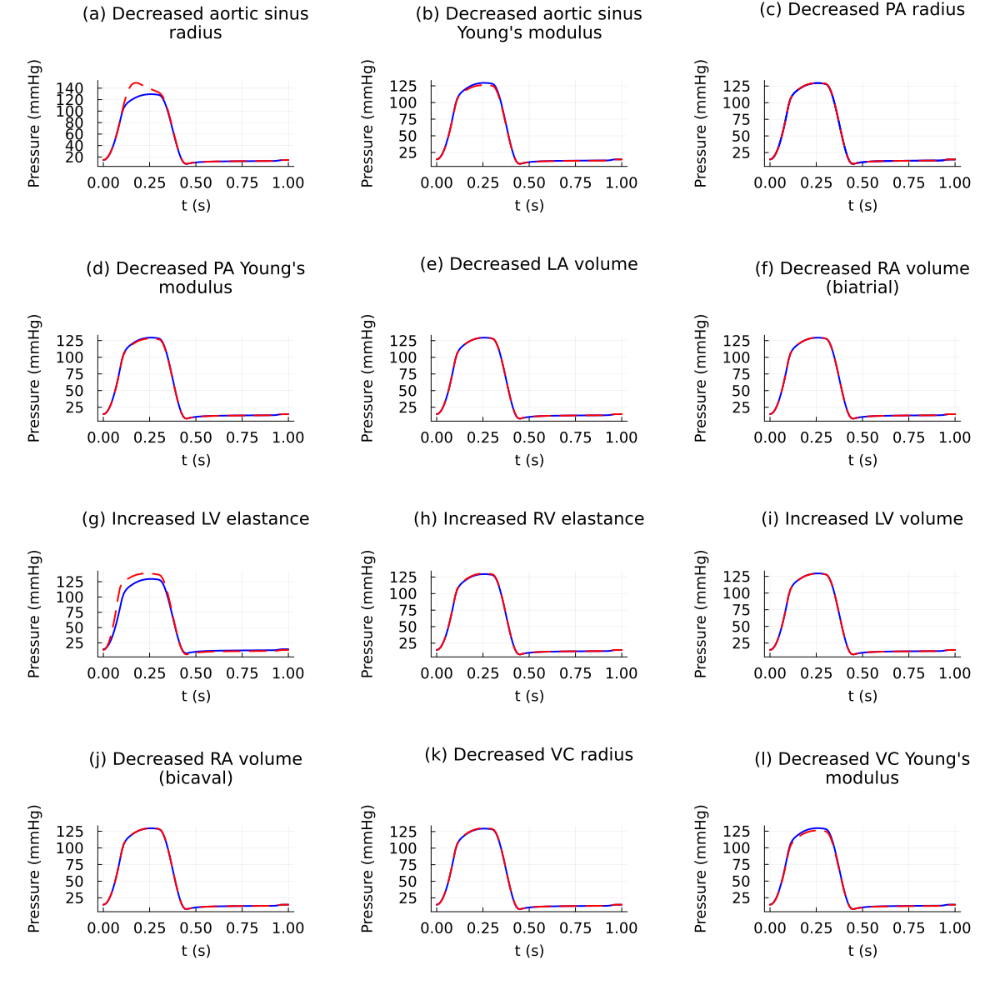

In [59]:
fig = plot(p_lv_pt_ao_r, p_lv_pt_ao_ym, p_lv_pt_pa_r, p_lv_pt_pa_ym, p_lv_pt_la_v0, 
        p_lv_pt_ra_v0_ba, p_lv_pt_lv_emax, p_lv_pt_rv_emax, p_lv_pt_lv_v0,
        p_lv_pt_ra_v0_bc, p_lv_pt_vc_r, p_lv_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/lv_pt.pdf")

## Pressure in RV

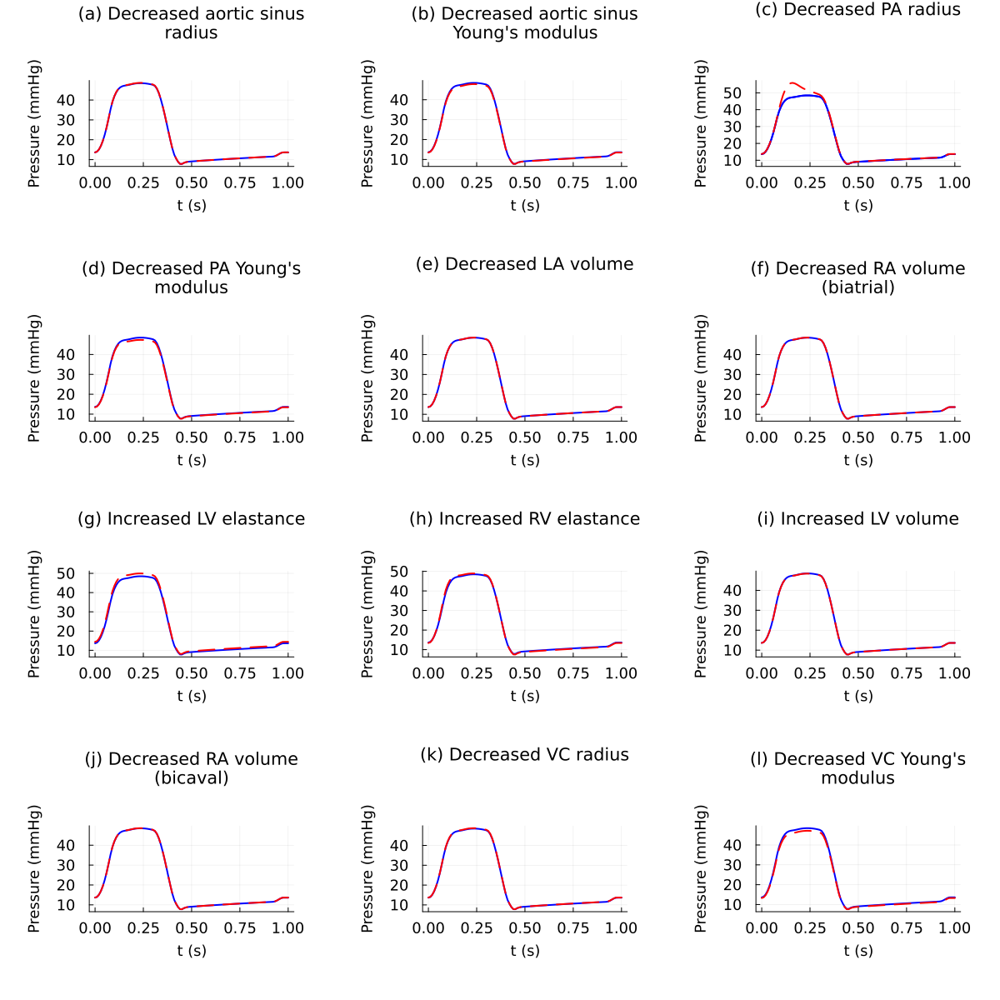

In [60]:
fig = plot(p_rv_pt_ao_r, p_rv_pt_ao_ym, p_rv_pt_pa_r, p_rv_pt_pa_ym, p_rv_pt_la_v0, 
        p_rv_pt_ra_v0_ba, p_rv_pt_lv_emax, p_rv_pt_rv_emax, p_rv_pt_lv_v0,
        p_rv_pt_ra_v0_bc, p_rv_pt_vc_r, p_rv_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/rv_pt.pdf")

## Pressure in LA

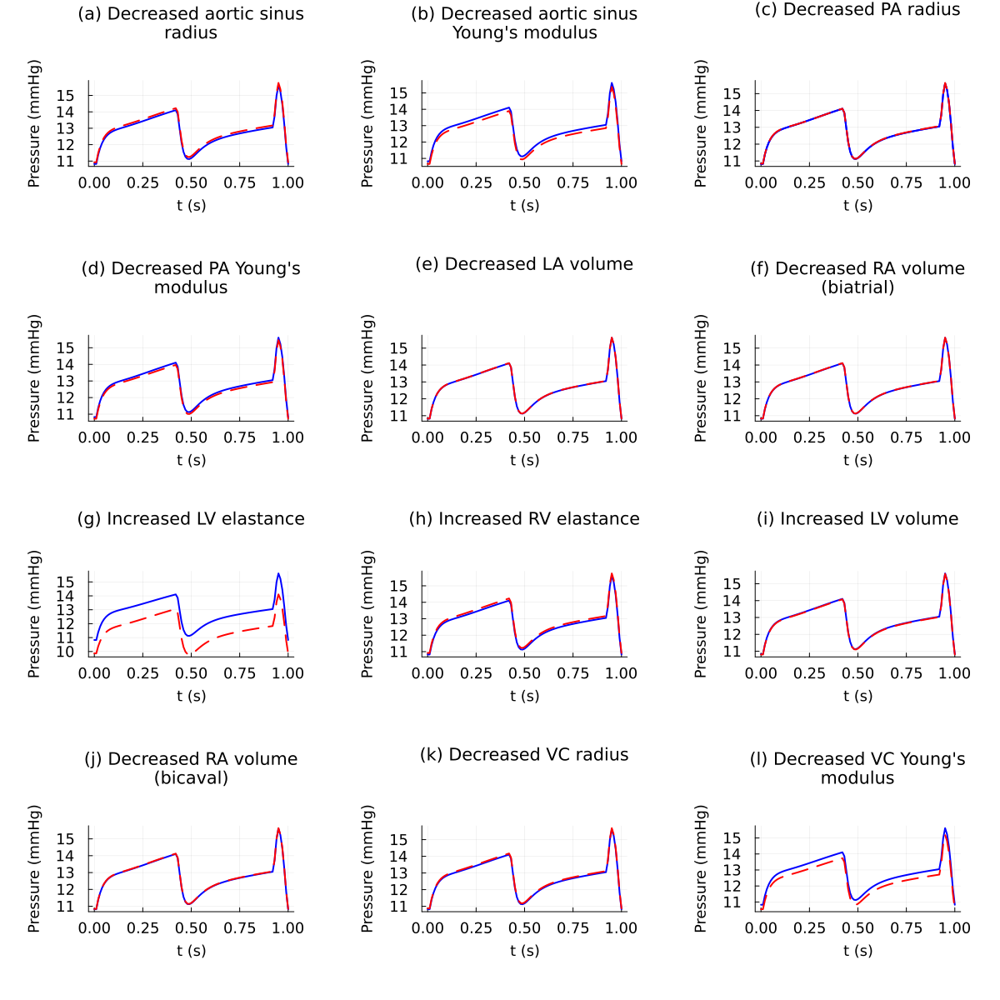

In [61]:
fig = plot(p_la_pt_ao_r, p_la_pt_ao_ym, p_la_pt_pa_r, p_la_pt_pa_ym, p_la_pt_la_v0, 
        p_la_pt_ra_v0_ba, p_la_pt_lv_emax, p_la_pt_rv_emax, p_la_pt_lv_v0,
        p_la_pt_ra_v0_bc, p_la_pt_vc_r, p_la_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/la_pt.pdf")

## Pressure in RA

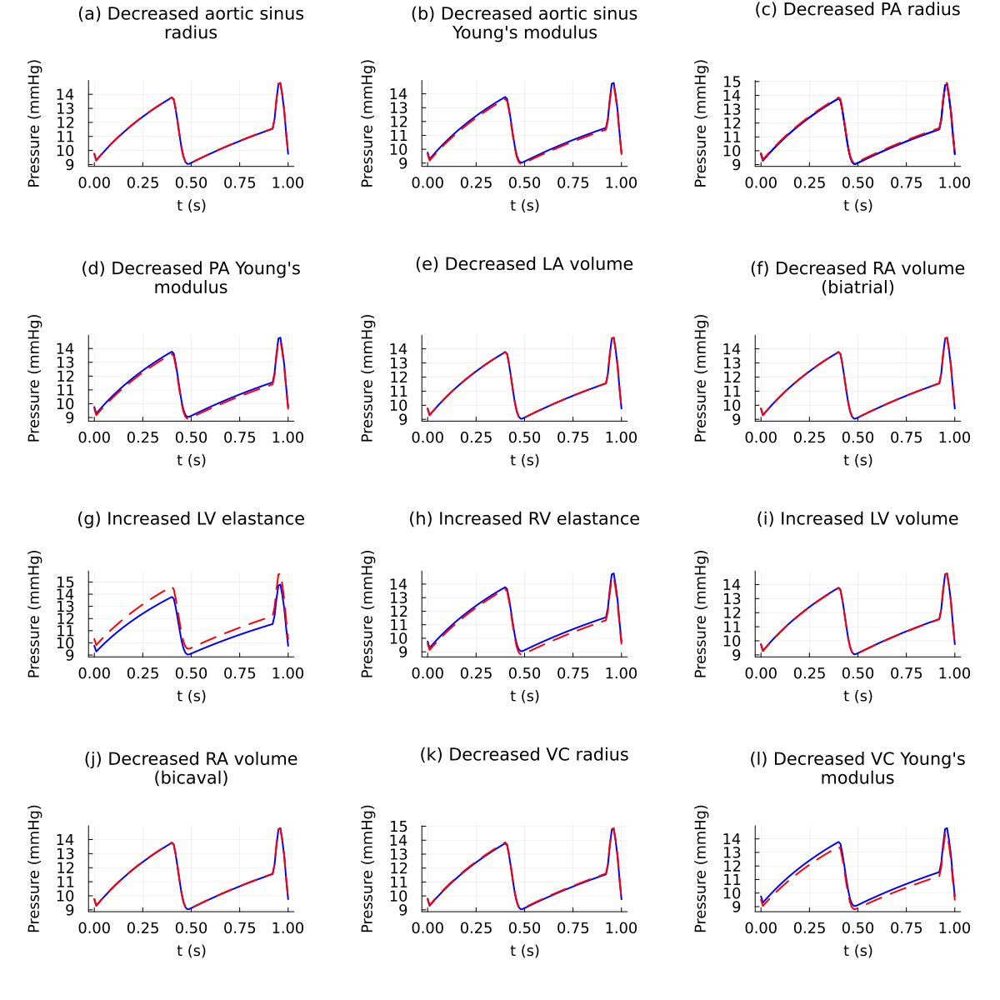

In [62]:
fig = plot(p_ra_pt_ao_r, p_ra_pt_ao_ym, p_ra_pt_pa_r, p_ra_pt_pa_ym, p_ra_pt_la_v0, 
        p_ra_pt_ra_v0_ba, p_ra_pt_lv_emax, p_ra_pt_rv_emax, p_ra_pt_lv_v0,
        p_ra_pt_ra_v0_bc, p_ra_pt_vc_r, p_ra_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/ra_pt.pdf")

## LV PV loop

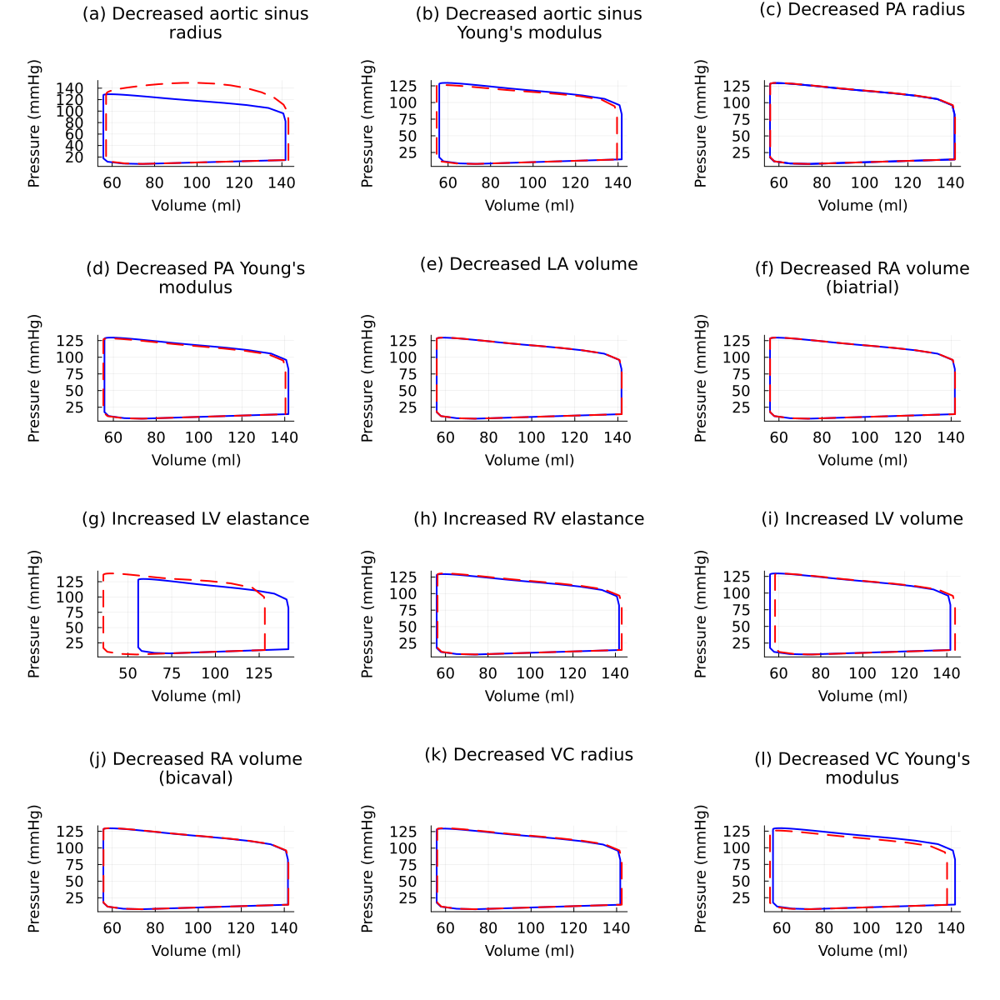

In [63]:
fig = plot(p_lv_pv_ao_r, p_lv_pv_ao_ym, p_lv_pv_pa_r, p_lv_pv_pa_ym, p_lv_pv_la_v0, 
        p_lv_pv_ra_v0_ba, p_lv_pv_lv_emax, p_lv_pv_rv_emax, p_lv_pv_lv_v0,
        p_lv_pv_ra_v0_bc, p_lv_pv_vc_r, p_lv_pv_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/lv_pv.pdf")

## RV PV loop

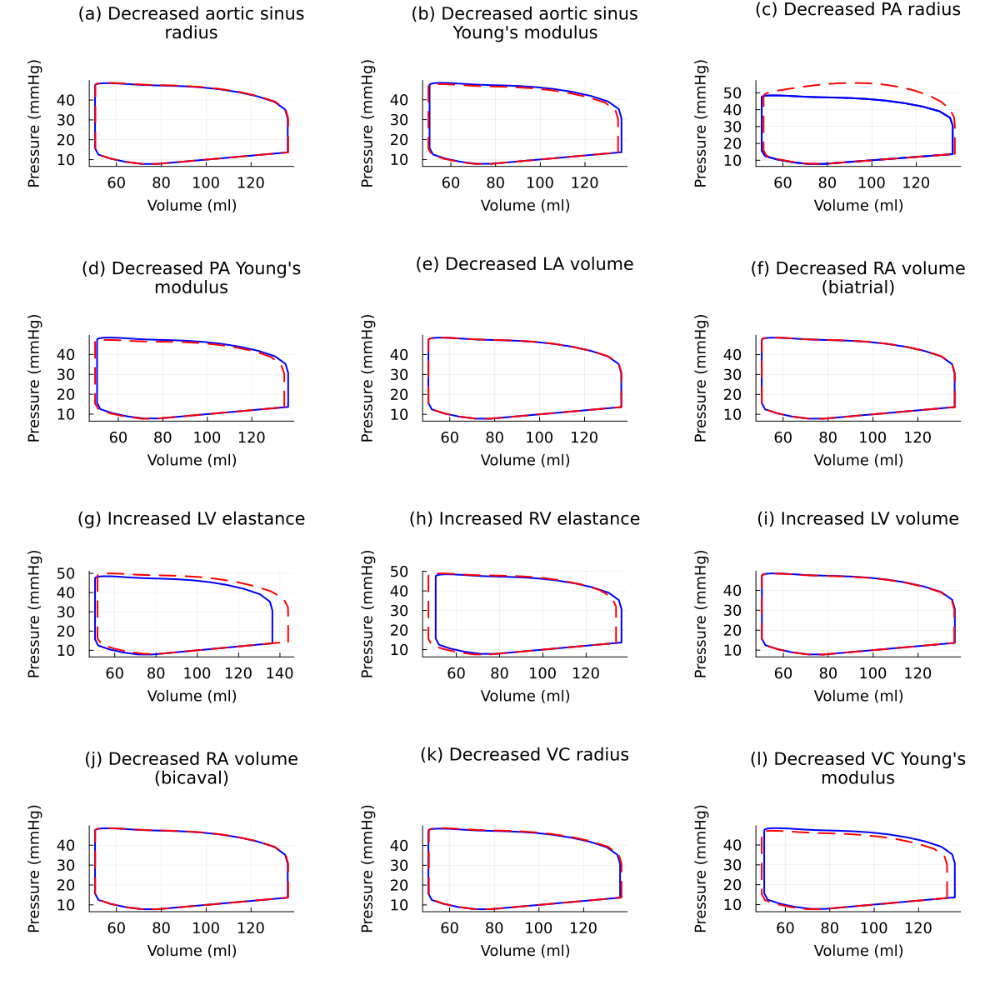

In [64]:
fig = plot(p_rv_pv_ao_r, p_rv_pv_ao_ym, p_rv_pv_pa_r, p_rv_pv_pa_ym, p_rv_pv_la_v0, 
        p_rv_pv_ra_v0_ba, p_rv_pv_lv_emax, p_rv_pv_rv_emax, p_rv_pv_lv_v0,
        p_rv_pv_ra_v0_bc, p_rv_pv_vc_r, p_rv_pv_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/rv_pv.pdf")

## LA PV loop

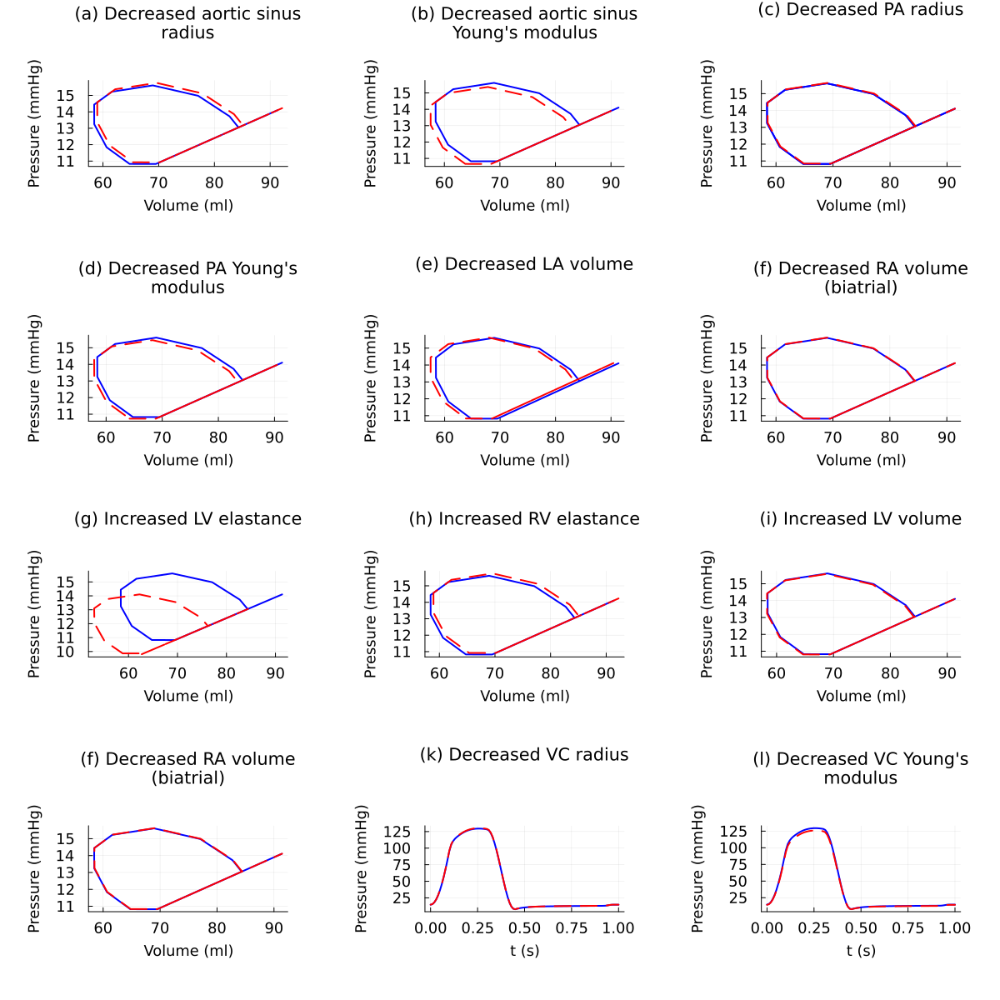

In [65]:
fig = plot(p_la_pv_ao_r, p_la_pv_ao_ym, p_la_pv_pa_r, p_la_pv_pa_ym, p_la_pv_la_v0, 
        p_la_pv_ra_v0_ba, p_la_pv_lv_emax, p_la_pv_rv_emax, p_la_pv_lv_v0,
        p_la_pv_ra_v0_ba, p_lv_pt_vc_r, p_lv_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/la_pv.pdf")

## RA PV loop

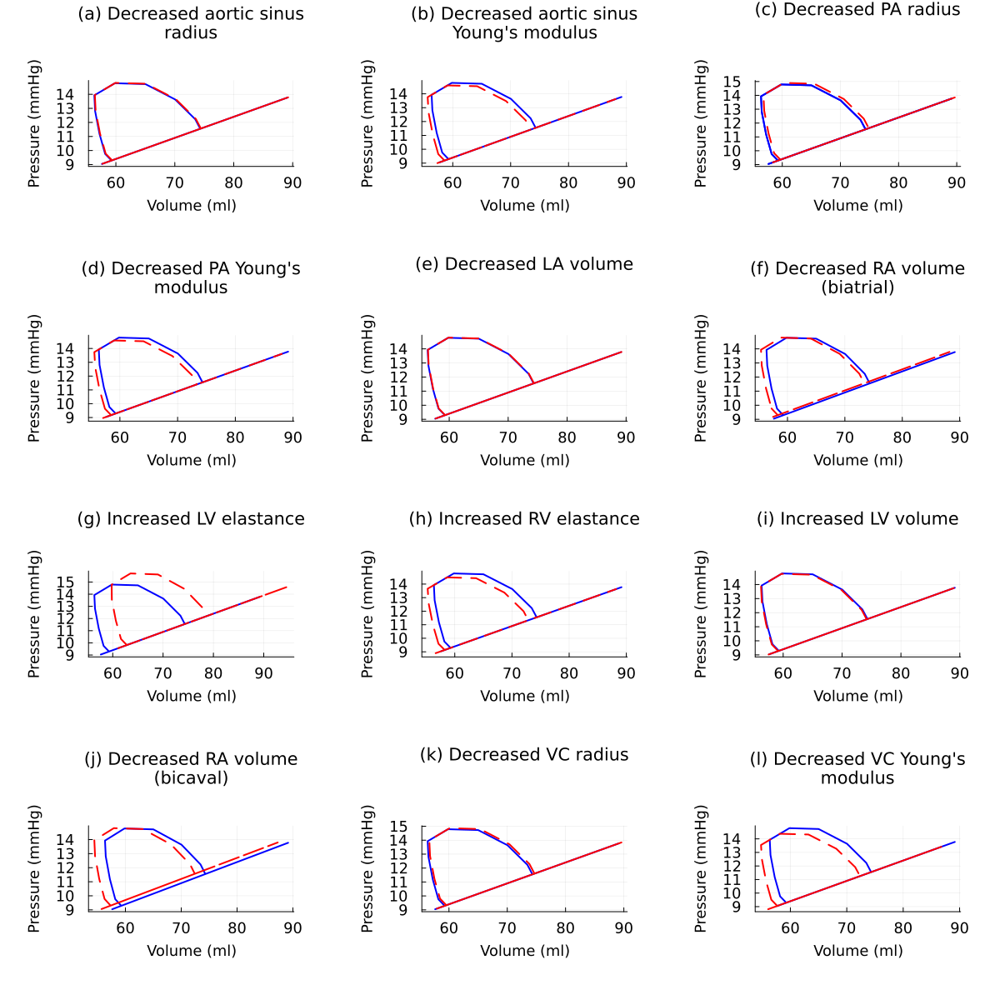

In [66]:
fig = plot(p_ra_pv_ao_r, p_ra_pv_ao_ym, p_ra_pv_pa_r, p_ra_pv_pa_ym, p_ra_pv_la_v0, 
        p_ra_pv_ra_v0_ba, p_ra_pv_lv_emax, p_ra_pv_rv_emax, p_ra_pv_lv_v0,
        p_ra_pv_ra_v0_bc, p_ra_pv_vc_r, p_ra_pv_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/ra_pv.pdf")

## Pressure in Aorta

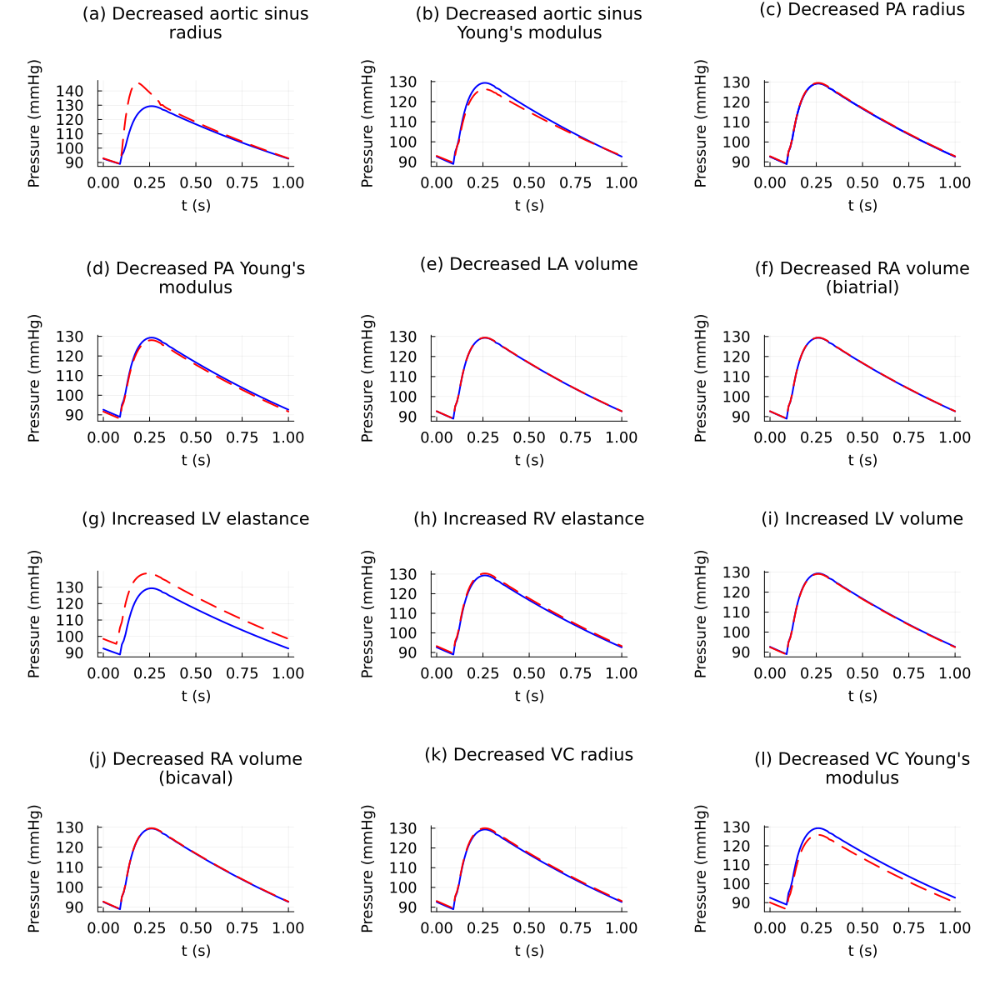

In [67]:
fig = plot(p_ao_pt_ao_r, p_ao_pt_ao_ym, p_ao_pt_pa_r, p_ao_pt_pa_ym, p_ao_pt_la_v0, 
        p_ao_pt_ra_v0_ba, p_ao_pt_lv_emax, p_ao_pt_rv_emax, p_ao_pt_lv_v0,
        p_ao_pt_ra_v0_bc, p_ao_pt_vc_r, p_ao_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/ao_pt.pdf")

## Pressure in PA

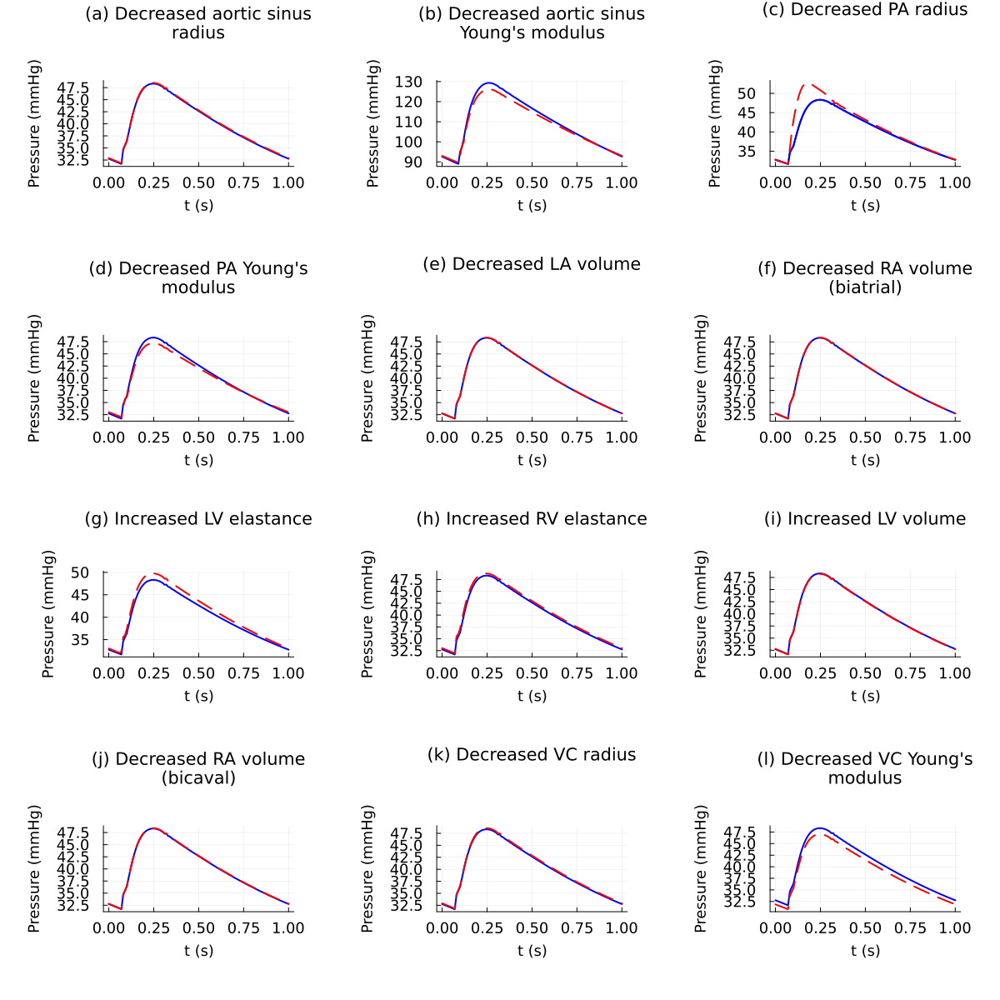

In [68]:
fig = plot(p_pa_pt_ao_r, p_ao_pt_ao_ym, p_pa_pt_pa_r, p_pa_pt_pa_ym, p_pa_pt_la_v0, 
        p_pa_pt_ra_v0_ba, p_pa_pt_lv_emax, p_pa_pt_rv_emax, p_pa_pt_lv_v0,
        p_pa_pt_ra_v0_bc, p_pa_pt_vc_r, p_pa_pt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/pa_pt.pdf")

## Volume in LV

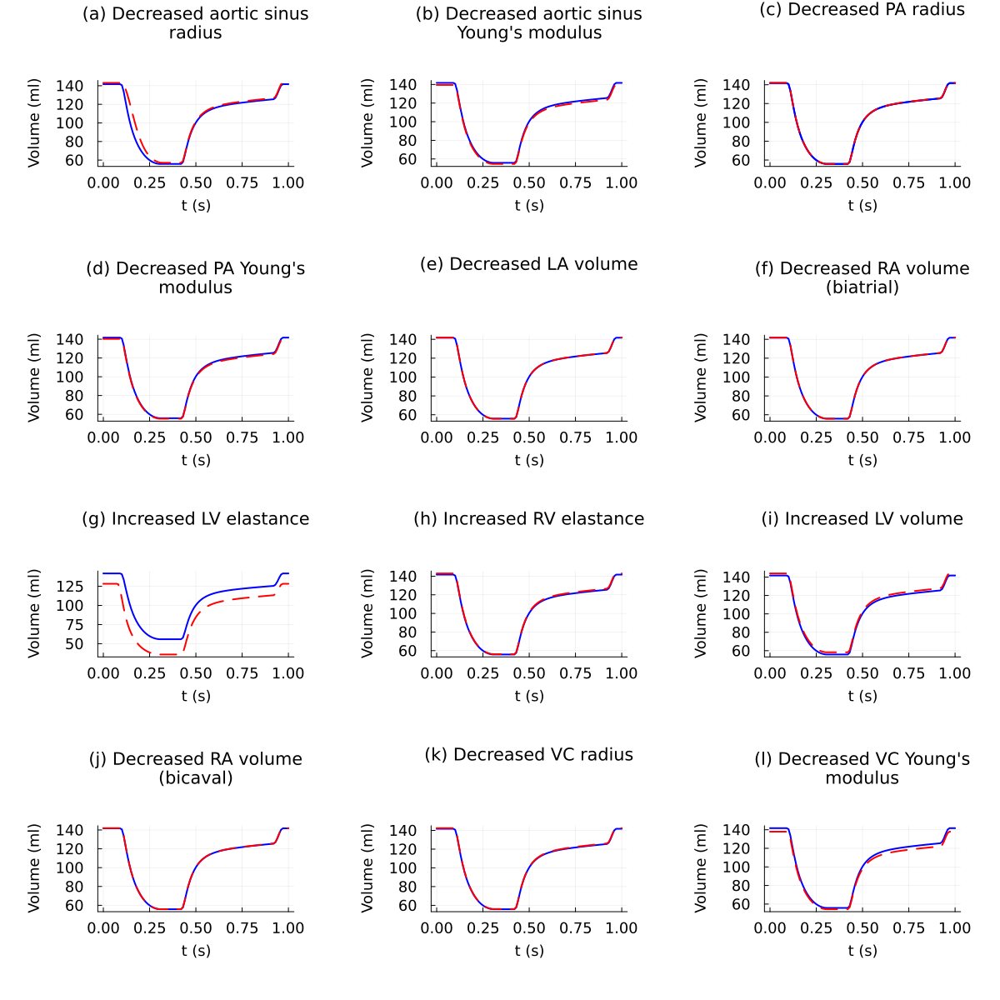

In [69]:
fig = plot(p_lv_vt_ao_r, p_lv_vt_ao_ym, p_lv_vt_pa_r, p_lv_vt_pa_ym, p_lv_vt_la_v0, 
        p_lv_vt_ra_v0_ba, p_lv_vt_lv_emax, p_lv_vt_rv_emax, p_lv_vt_lv_v0,
        p_lv_vt_ra_v0_bc, p_lv_vt_vc_r, p_lv_vt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/lv_vt.pdf")

## Volume in RV

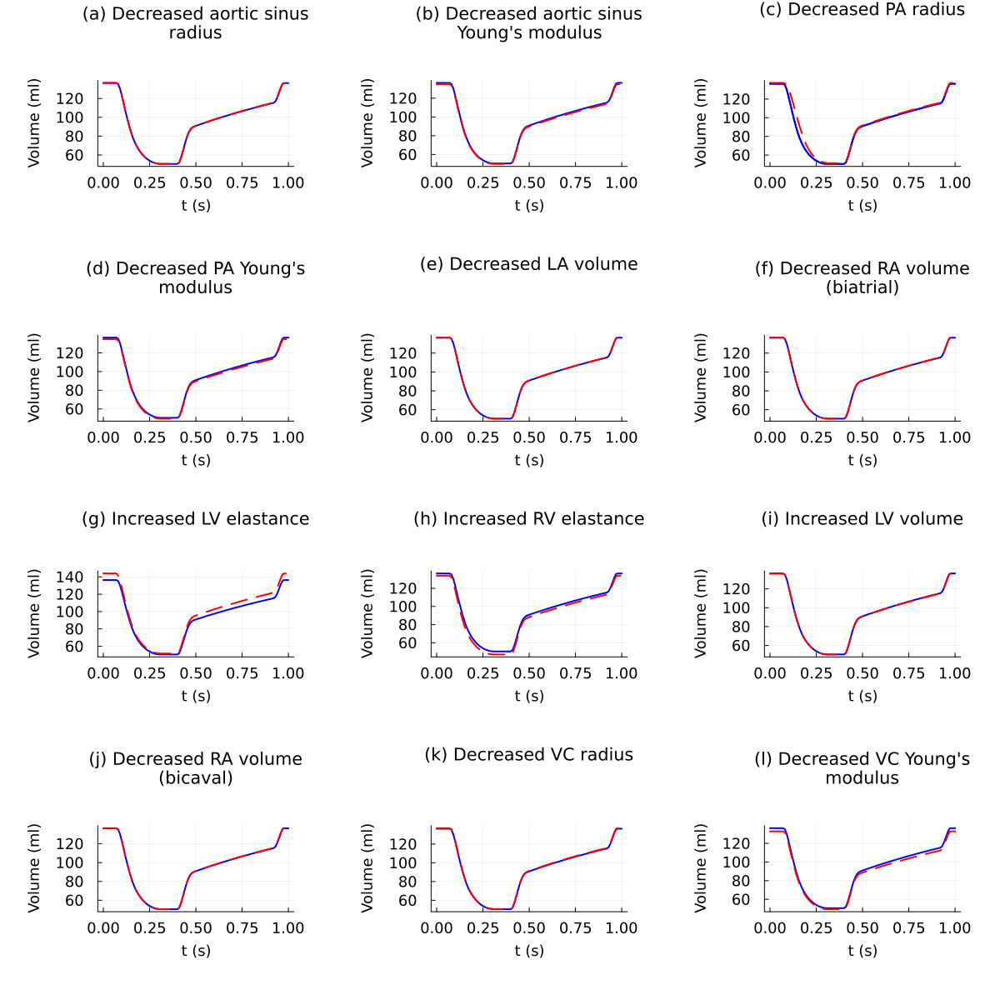

In [70]:
fig = plot(p_rv_vt_ao_r, p_rv_vt_ao_ym, p_rv_vt_pa_r, p_rv_vt_pa_ym, p_rv_vt_la_v0, 
        p_rv_vt_ra_v0_ba, p_rv_vt_lv_emax, p_rv_vt_rv_emax, p_rv_vt_lv_v0,
        p_rv_vt_ra_v0_bc, p_rv_vt_vc_r, p_rv_vt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/rv_vt.pdf")

## Volume in LA

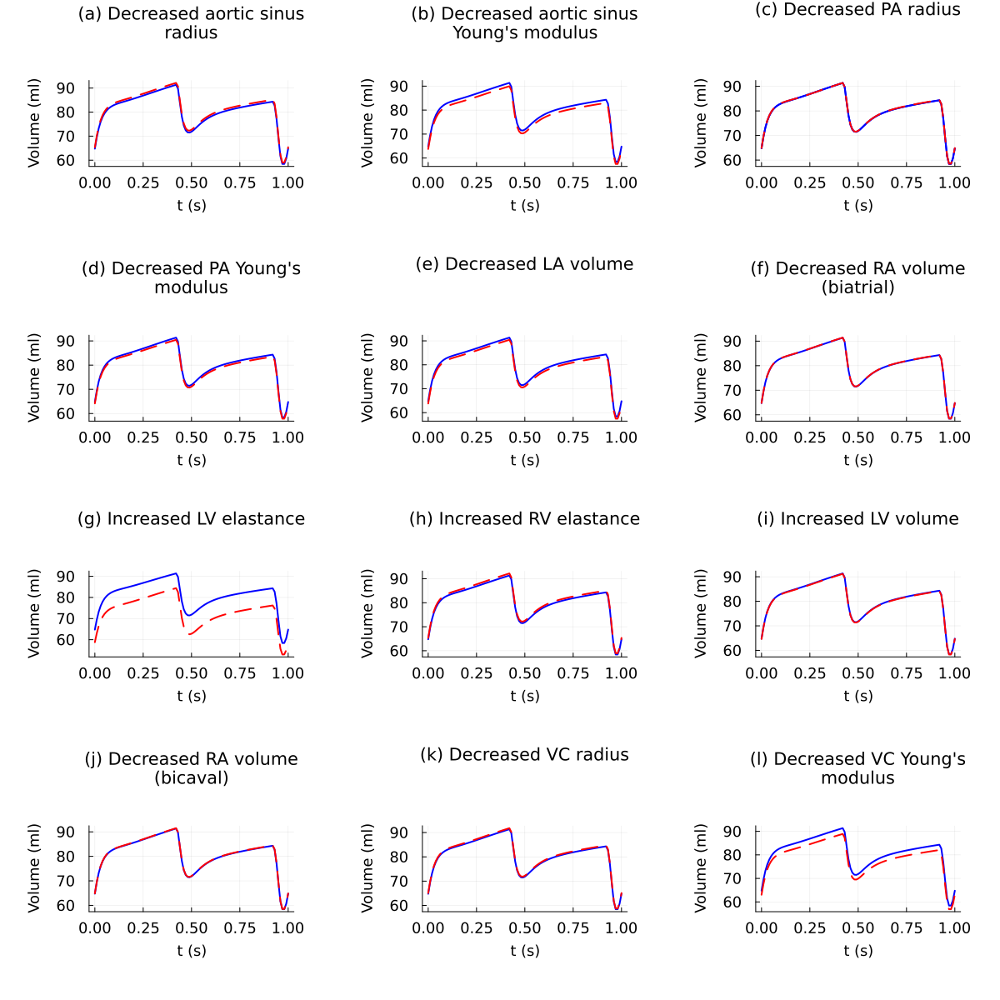

In [71]:
fig = plot(p_la_vt_ao_r, p_la_vt_ao_ym, p_la_vt_pa_r, p_la_vt_pa_ym, p_la_vt_la_v0, 
        p_la_vt_ra_v0_ba, p_la_vt_lv_emax, p_la_vt_rv_emax, p_la_vt_lv_v0,
        p_la_vt_ra_v0_bc, p_la_vt_vc_r, p_la_vt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/la_vt.pdf")

## Volume in RA

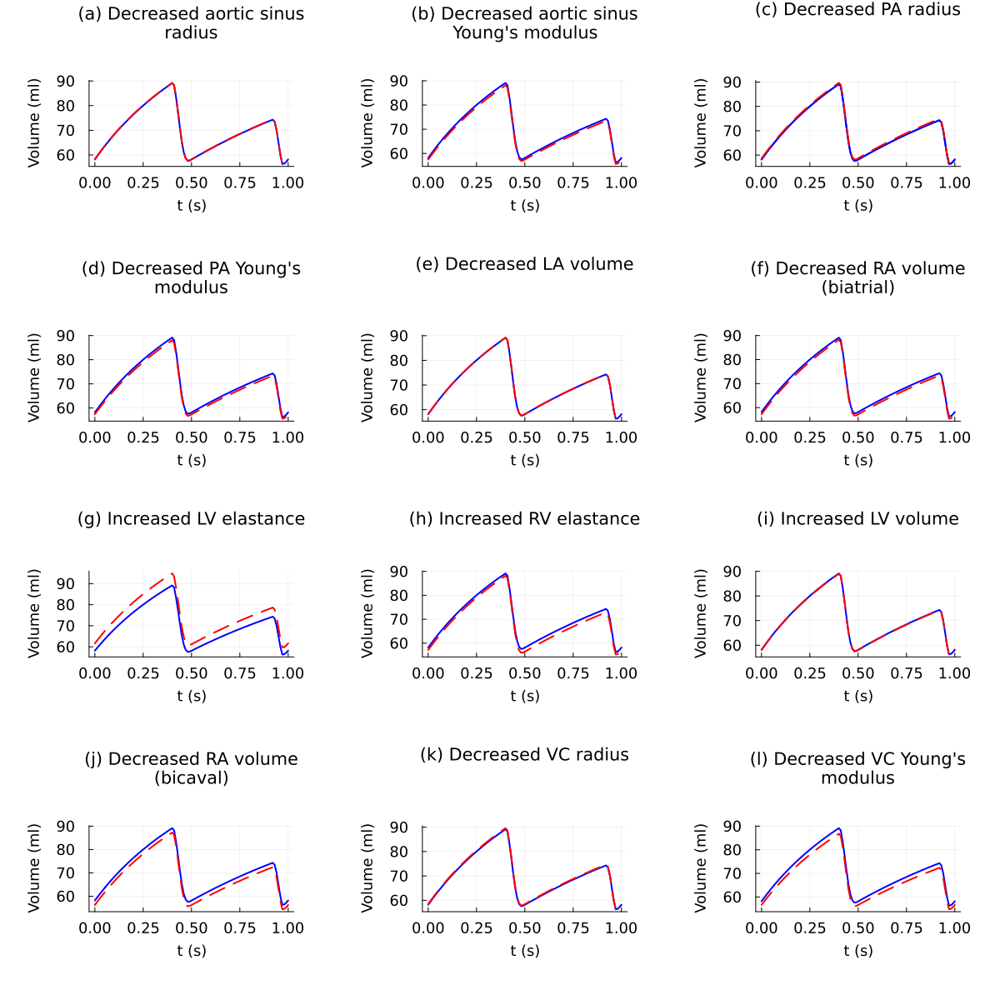

In [72]:
fig = plot(p_ra_vt_ao_r, p_ra_vt_ao_ym, p_ra_vt_pa_r, p_ra_vt_pa_ym, p_ra_vt_la_v0, 
        p_ra_vt_ra_v0_ba, p_ra_vt_lv_emax, p_ra_vt_rv_emax, p_ra_vt_lv_v0,
        p_ra_vt_ra_v0_bc, p_ra_vt_vc_r, p_ra_vt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/ra_vt.pdf")

## Aorta volume

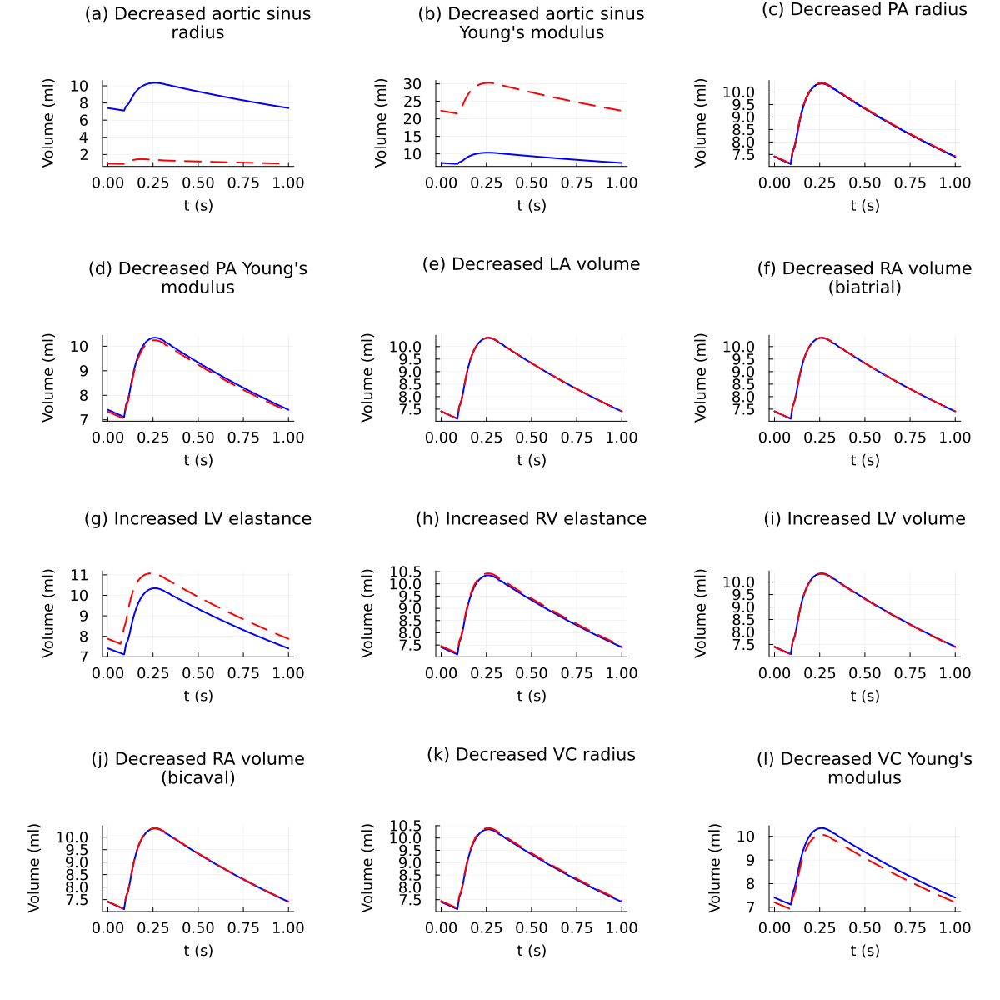

In [73]:
fig = plot(p_ao_vt_ao_r, p_ao_vt_ao_ym, p_ao_vt_pa_r, p_ao_vt_pa_ym, p_ao_vt_la_v0, 
        p_ao_vt_ra_v0_ba, p_ao_vt_lv_emax, p_ao_vt_rv_emax, p_ao_vt_lv_v0,
        p_ao_vt_ra_v0_bc, p_ao_vt_vc_r, p_ao_vt_vc_ym, 
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/ao_vt.pdf")

## PA volume

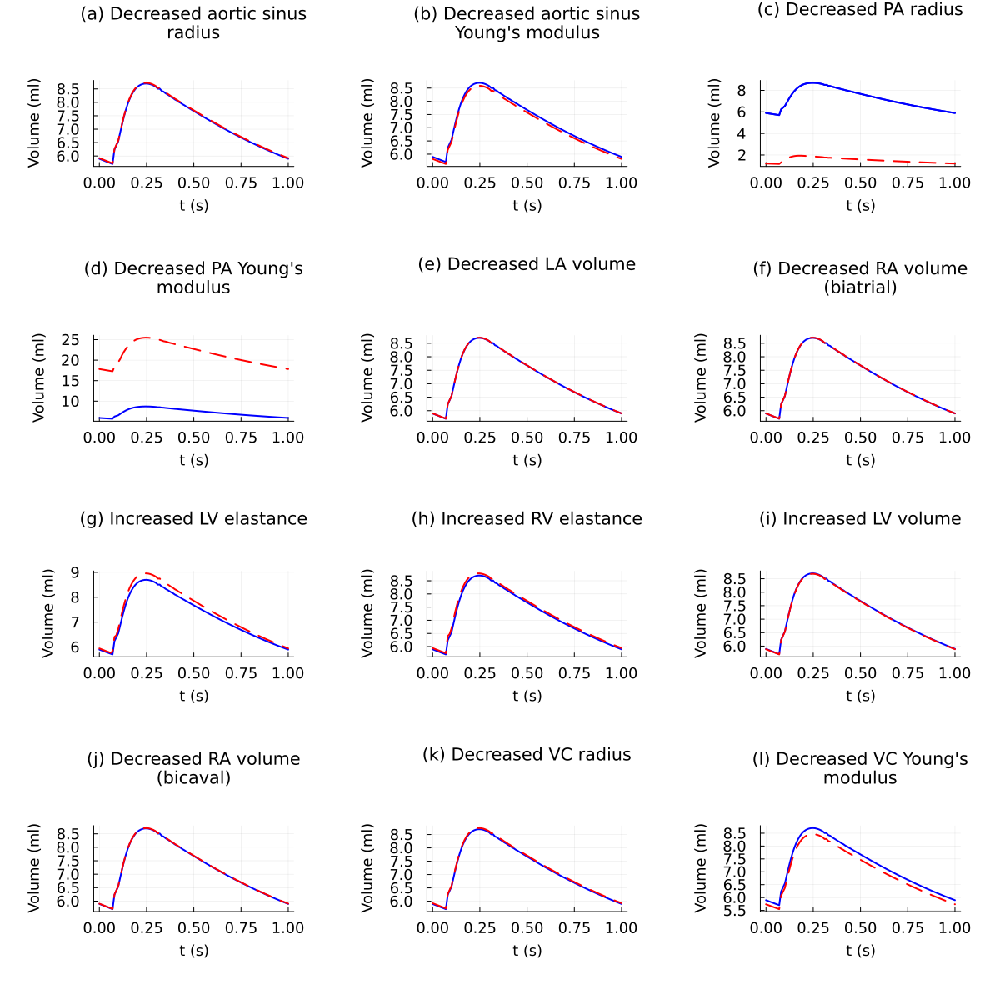

In [74]:
fig = plot(p_pa_vt_ao_r, p_pa_vt_ao_ym, p_pa_vt_pa_r, p_pa_vt_pa_ym, p_pa_vt_la_v0, 
        p_pa_vt_ra_v0_ba, p_pa_vt_lv_emax, p_pa_vt_rv_emax, p_pa_vt_lv_v0,
        p_pa_vt_ra_v0_bc, p_pa_vt_vc_r, p_pa_vt_vc_ym,
        layout=(4,3), margin=10Plots.mm)
plot!(size=(1200,1200))
# savefig(fig, "arrangement_2_plots/pa_vt.pdf")